## A Musical Example

In [1]:
from scipy.io import wavfile
import pandas as pd
import numpy as np

?wavfile.read

Signature: wavfile.read(filename, mmap=False)
Docstring:
Open a WAV file

Return the sample rate (in samples/sec) and data from a WAV file.

Parameters
----------
filename : string or open file handle
    Input wav file.
mmap : bool, optional
    Whether to read data as memory-mapped.
    Only to be used on real files (Default: False).

    .. versionadded:: 0.12.0

Returns
-------
rate : int
    Sample rate of wav file.
data : numpy array
    Data read from wav file.  Data-type is determined from the file;
    see Notes.

Notes
-----
This function cannot read wav files with 24-bit data.

Common data types: [1]_

=====================  ===========  ===========  =============
     WAV format            Min          Max       NumPy dtype
=====================  ===========  ===========  =============
32-bit floating-point  -1.0         +1.0         float32
32-bit PCM             -2147483648  +2147483647  int32
16-bit PCM             -32768       +32767       int16
8-bit PCM              0

In [2]:
#fs is the sample rate, so time=samples/fs
[fs,data]=wavfile.read('datasets/pianoclip.wav','r') #reads in wavfile
df=pd.DataFrame(data)  #creates dataframe with ata
df = df.rename({0: 'Amplitude'}, axis=1)   #renames 
df.plot()

In [3]:
df.head()

,Amplitude
0,-1
1,-1
2,-1
3,-1
4,-1


In [4]:
fs  #44100 samples (rows) per second

44100

In [5]:
df.iloc[100000] #amplitude is -1240

Amplitude   -1240
Name: 100000, dtype: int16

In [6]:
#playing clip
from IPython.display import Audio    
sound_file = 'datasets/pianoclip.wav'
Audio(sound_file)

In [7]:
duration = 80      #creating variable duration which equals 80
index = pd.date_range('00:00:00', periods=fs*duration, freq='22.676us')  #making date_range starting at 00:00:00 with the periods being fs times duration and the freq is 22.67us
index

DatetimeIndex([          '2021-03-06 00:00:00',
               '2021-03-06 00:00:00.000022676',
               '2021-03-06 00:00:00.000045352',
               '2021-03-06 00:00:00.000068028',
               '2021-03-06 00:00:00.000090704',
               '2021-03-06 00:00:00.000113380',
               '2021-03-06 00:00:00.000136056',
               '2021-03-06 00:00:00.000158732',
               '2021-03-06 00:00:00.000181408',
               '2021-03-06 00:00:00.000204084',
               ...
               '2021-03-06 00:01:20.000701240',
               '2021-03-06 00:01:20.000723916',
               '2021-03-06 00:01:20.000746592',
               '2021-03-06 00:01:20.000769268',
               '2021-03-06 00:01:20.000791944',
               '2021-03-06 00:01:20.000814620',
               '2021-03-06 00:01:20.000837296',
               '2021-03-06 00:01:20.000859972',
               '2021-03-06 00:01:20.000882648',
               '2021-03-06 00:01:20.000905324'],
              dtype=

In [8]:
df.index = index  #setting index to the index variable that was created

In [9]:
df.head()   #getting first few rows of df

,Amplitude
2021-03-06 00:00:00.000000000,-1
2021-03-06 00:00:00.000022676,-1
2021-03-06 00:00:00.000045352,-1
2021-03-06 00:00:00.000068028,-1
2021-03-06 00:00:00.000090704,-1


In [14]:
start = np.datetime64('2021-03-05 00:00:00.000000000') #creating starting value
track1_end = pd.Timedelta('23s')  #first track ends after 23 seconds
track2_end = pd.Timedelta('51s') #second track ends after 51 seconds

track1 = df[:start + track1_end] #track 1 starts at 0 and ends at track1_end
track2 = df[start + track1_end: start + track2_end]  #track2 start time is start + where track1_end to start and track2_end
track3 = df[start + track2_end:]  #track3 starts where track2_ends and goes to whatevers left

cut_data = np.array(track2) #technicality to turn track2 to an array
wavfile.write('datasets/test.wav', fs, cut_data)  #write as a file with sampling rate and data

In [15]:

from IPython.display import Audio
sound_file = 'datasets/test.wav'
Audio(sound_file)

In [17]:
#a bit of unit conversions...
bpm = 103  #beats per minute
bps = bpm /60   #beats per minute divided by 60
beats_per_measure = 4  

samples_per_beat = fs / bps  #(samples/second) * (second/beat)
samples_per_measure = samples_per_beat * beats_per_measure

[fs,data]=wavfile.read('datasets/test.wav', 'r')
clip = pd.DataFrame(data)
clip = df.rename({0: 'Amplitude'}, axis=1)

In [18]:
measures = np.arange(0, len(clip), samples_per_measure).round().astype(int)
measures

array([      0,  102757,  205515,  308272,  411029,  513786,  616544,
        719301,  822058,  924816, 1027573, 1130330, 1233087, 1335845,
       1438602, 1541359, 1644117, 1746874, 1849631, 1952388, 2055146,
       2157903, 2260660, 2363417, 2466175, 2568932, 2671689, 2774447,
       2877204, 2979961, 3082718, 3185476, 3288233, 3390990, 3493748])

In [22]:
measure = clip.iloc[measures[0]:measures[2]]
cut_data = np.array(measure)
wavfile.write('datasets/measure.wav', fs, cut_data)

from IPython.display import Audio
sound_file = 'datasets/measure.wav'
Audio(sound_file)


In [25]:
distort = clip.resample('15us').ffill()

In [24]:
len(distort)

5333394

In [29]:
cut_data=np.array(distort)
wavfile.write('datasets/distort.wav',fs,cut_data)

from IPython.display import Audio
sound_file = 'datasets/distort.wav'
Audio(sound_file)

In [30]:
distort = clip.resample('30us').ffill()

In [31]:
len(distort)

2666697

In [32]:
cut_data=np.array(distort)
wavfile.write('datasets/distort.wav',fs,cut_data)

In [33]:
from IPython.display import Audio
sound_file = 'datasets/distort.wav'
Audio(sound_file)

## Moving Window Functions
* Sometimes we want to do manipulation on a chunk of a dataframe by time period, e.g. 5 mins, instead of using groups
* We can do this by just indexing into the dataframe with a date range comparison
* Let's look at examples on the stock market with Amazon


In [34]:
import pandas as pd
df = pd.read_csv("datasets/AMZN.csv")   #reading amazon stock data
df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,1997-05-15,2.437500,2.500000,1.927083,1.958333,1.958333,72156000
1,1997-05-16,1.968750,1.979167,1.708333,1.729167,1.729167,14700000
2,1997-05-19,1.760417,1.770833,1.625000,1.708333,1.708333,6106800
3,1997-05-20,1.729167,1.750000,1.635417,1.635417,1.635417,5467200
4,1997-05-21,1.635417,1.645833,1.375000,1.427083,1.427083,18853200


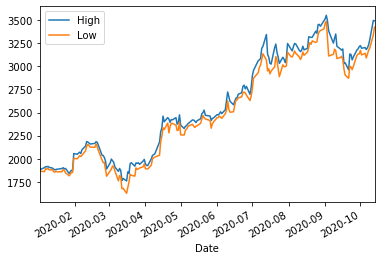

In [35]:
%matplotlib inline
# Let's look at the highs and lows
# just by this year
amzn = df[['High', 'Low']].set_index(pd.to_datetime(df['Date'])) #looking at high and low columns and setting index to datetime of date column
amzn = amzn[amzn.index > '2020-01-01']   #mask with all indexes greater than 2020-01-01

import matplotlib.pyplot as plt   #importing matplotlib
amzn.plot()  #plotting amzn
# notice we have two lines!

* The `rolling()` operator lets us specify a window size and apply a function that works on that much data to every point in our time series
* Close your eyes and imagine now one of those stock prices over time. How would we calculate the 7 day moving average?
* First, what does the 7 day moving average even mean?


* Now, what's the algorithm you would use to calculate it?

In [25]:
import numpy as np
for i in range(7, 20):   #for a number in range of 7 to 20 
    print(np.mean(amzn.iloc[i-7:i]['High']))  #get the past 7 values up to now from column High and calculate the mean

1905.364257714286
1905.3628277142857
1905.4928325714286
1901.945696
1897.9028318571425
1894.4228339999997
1891.0585588571428
1890.4242815714283
1889.2785644285711
1890.4042794285713
1884.9957101428572
1881.0699985714284
1879.371425


* In pandas, the `rolling` function allows us to do this with arbitrary window sizes and a function

In [36]:
# Here, let's do a 7 day rolling on the dataframe
# Note the output we get back
amzn.rolling(7).apply(np.mean).head(20)  #7 day rolling average from amzn and apply mean and get 20 values

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Currently, 'apply' passes the values as ndarrays to the applied function. In the future, this will change to passing it as Series objects. You need to specify 'raw=True' to keep the current behaviour, and you can pass 'raw=False' to silence this warning
  This is separate from the ipykernel package so we can avoid doing imports until


,High,Low
Date,,
2020-01-02,NaN,NaN
2020-01-03,NaN,NaN
2020-01-06,NaN,NaN
2020-01-07,NaN,NaN
2020-01-08,NaN,NaN
2020-01-09,NaN,NaN
2020-01-10,1905.364258,1877.561436
2020-01-13,1905.362828,1879.940011
2020-01-14,1905.492833,1879.090018


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: Currently, 'apply' passes the values as ndarrays to the applied function. In the future, this will change to passing it as Series objects. You need to specify 'raw=True' to keep the current behaviour, and you can pass 'raw=False' to silence this warning
  after removing the cwd from sys.path.


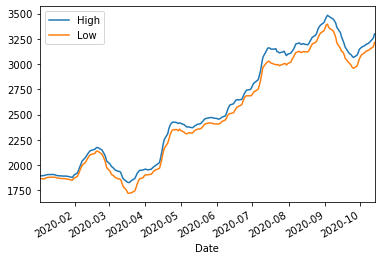

In [29]:
# There are the usual benefits (faster, less error prone, not icky) versus iteration
# We can also control those NaN's by specifying how much data we want to be present
# before applying the function

amzn.rolling(7, min_periods=1).apply(np.mean).plot() #min_periods is the minimum nuber of observations in window required to have a value

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Currently, 'apply' passes the values as ndarrays to the applied function. In the future, this will change to passing it as Series objects. You need to specify 'raw=True' to keep the current behaviour, and you can pass 'raw=False' to silence this warning
  


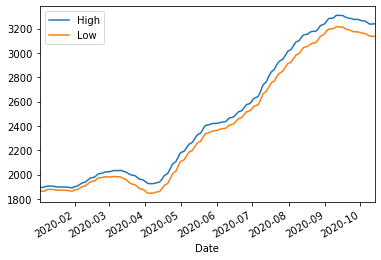

In [30]:
# here's a 30 day moving average
amzn.rolling(30, min_periods=1).apply(np.mean).plot()  #30 day rolling average, the higher the number becomes the more line smooths out up to a point

# Time Series and Gaps
What do we do when we have missing data in a time series?

In [38]:
import pandas as pd
# Let's look at some data reported cases of measles in England and Wales
df=pd.read_csv("datasets/ewcitmeas.txt", delim_whitespace=True, dtype=float, na_values="*")  #mesels data
df.head()

,DD,MM,YY,London,Bristol,Liverpool,Manchester,Newcastle,Birmingham,Sheffield
0,10.0,1.0,48.0,NaN,3.0,40.0,22.0,58.0,78.0,9.0
1,17.0,1.0,48.0,240.0,4.0,51.0,19.0,52.0,84.0,11.0
2,24.0,1.0,48.0,284.0,3.0,54.0,23.0,34.0,65.0,11.0
3,31.0,1.0,48.0,340.0,5.0,54.0,31.0,25.0,106.0,4.0
4,7.0,2.0,48.0,511.0,1.0,89.0,66.0,27.0,142.0,7.0


In [39]:
# What a painful date time format! 
df.rename(columns={'DD': 'day', 'MM': 'month', 'YY': 'year'}, inplace=True)  #renaming columns, setting inplace to True so you don't have to reassign it to itself
df['year'] = df['year'] + 1900   #setting year column data adding 1900    ex 48  now is 1948
df= df.set_index(pd.to_datetime(df[['year', 'month', 'day']])).drop(['day', 'month', 'year'], axis = 'columns') #setting index to to_datetime of year month day and dropping day month year, axis is columns
df.head()

,London,Bristol,Liverpool,Manchester,Newcastle,Birmingham,Sheffield
1948-01-10,NaN,3.0,40.0,22.0,58.0,78.0,9.0
1948-01-17,240.0,4.0,51.0,19.0,52.0,84.0,11.0
1948-01-24,284.0,3.0,54.0,23.0,34.0,65.0,11.0
1948-01-31,340.0,5.0,54.0,31.0,25.0,106.0,4.0
1948-02-07,511.0,1.0,89.0,66.0,27.0,142.0,7.0


In [40]:
%matplotlib inline
# we can setup some features for matplotlib here
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = 12, 8

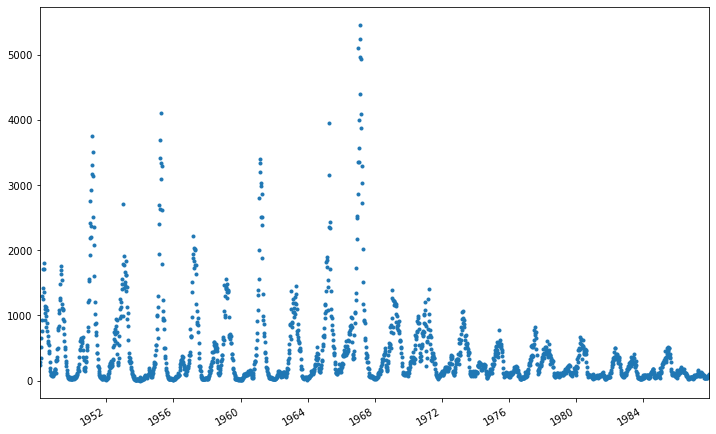

In [41]:
# instead of the line plots we have been using, let's look at a scatter plot
df['London'].plot(style='.')  #plotting scatter plot

* We notice several things here. First, the seasonality of the measels is shown. Second, the weekly resolution makes sense sometimes, but at other times it seems like we could be helped with more frequent data collection

In [43]:
# I want to show you how to deal with holes in your data
# I'm just going to pull out 500 observations as an example into a new dataframe
df2=df["London"].sample(500)  
# Now, look at the randomness of dates/values in the dataframe itself
display(df2.head())

1982-01-29    131.0
1960-09-03     61.0
1966-01-22    205.0
1972-03-17    191.0
1978-09-22     63.0
Name: London, dtype: float64

* We have another great option in pandas, which is the `interpolate()` function.
* Interpolate fills NaN values in different ways depending upon the parameters you pass
* It actually has some specific time series benefits but only for higher frequency data (day or better)

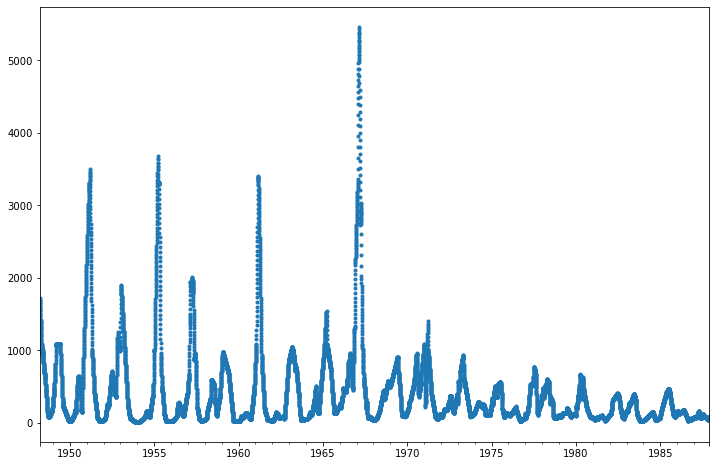

In [44]:
df2.resample('D').interpolate(method='linear').plot(style='.') #resampling by day

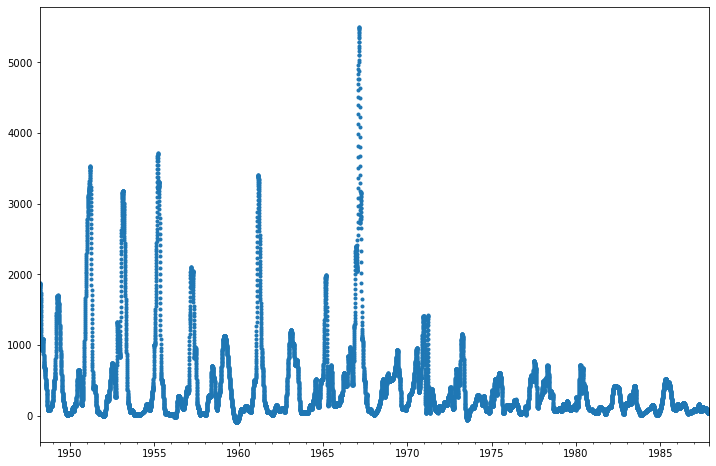

In [45]:
df2.resample('D').interpolate(method='polynomial', order=3).plot(style='.')

https://machinelearningmastery.com/statistical-hypothesis-tests/